# LIBs

In [1]:
# Import Libraries
import joblib
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
import xgboost as xgb
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, recall_score, precision_score, f1_score
import warnings
warnings.filterwarnings("ignore")


# Data

In [2]:
# Load Data
brest_cancer_df = pd.read_csv("data.csv")
brest_cancer_df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


# Data Preprocessing & EDA

In [3]:
# Data Info
brest_cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [ ]:
# NO missing values
# All features are numeric, with the exception of the diagnosis variable.

In [4]:
# Data Description
brest_cancer_df.describe(include="all")

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
unique,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,357,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,3.037183e+07,NaN,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,NaN,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,NaN,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,NaN,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,NaN,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,NaN,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN


In [ ]:
# The description reveals that the data is on different scales.

In [5]:
# Drop Non-Important Features
brest_cancer_df.drop(["id", "Unnamed: 32"], axis=1, inplace=True)
brest_cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

In [ ]:
# The "id" and "Unnamed: 32" columns do not provide any relevant information regarding the diagnosis.

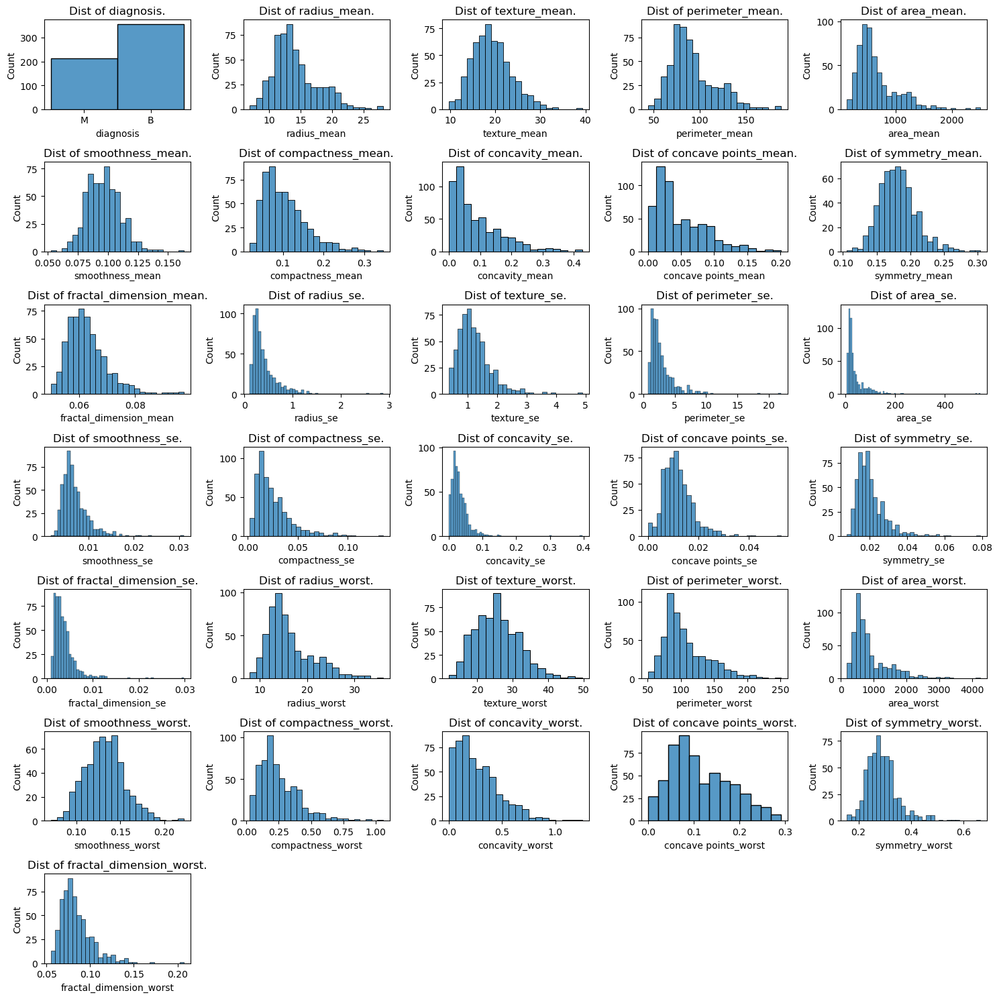

In [6]:
# Data Distribution
plt.figure(figsize=(15,15))
for idx, col in enumerate(brest_cancer_df.columns):
    plt.subplot(7,5,idx+1)
    sns.histplot(x=col, data=brest_cancer_df)
    plt.title(f"Dist of {col}.")
 
plt.tight_layout()
plt.show()

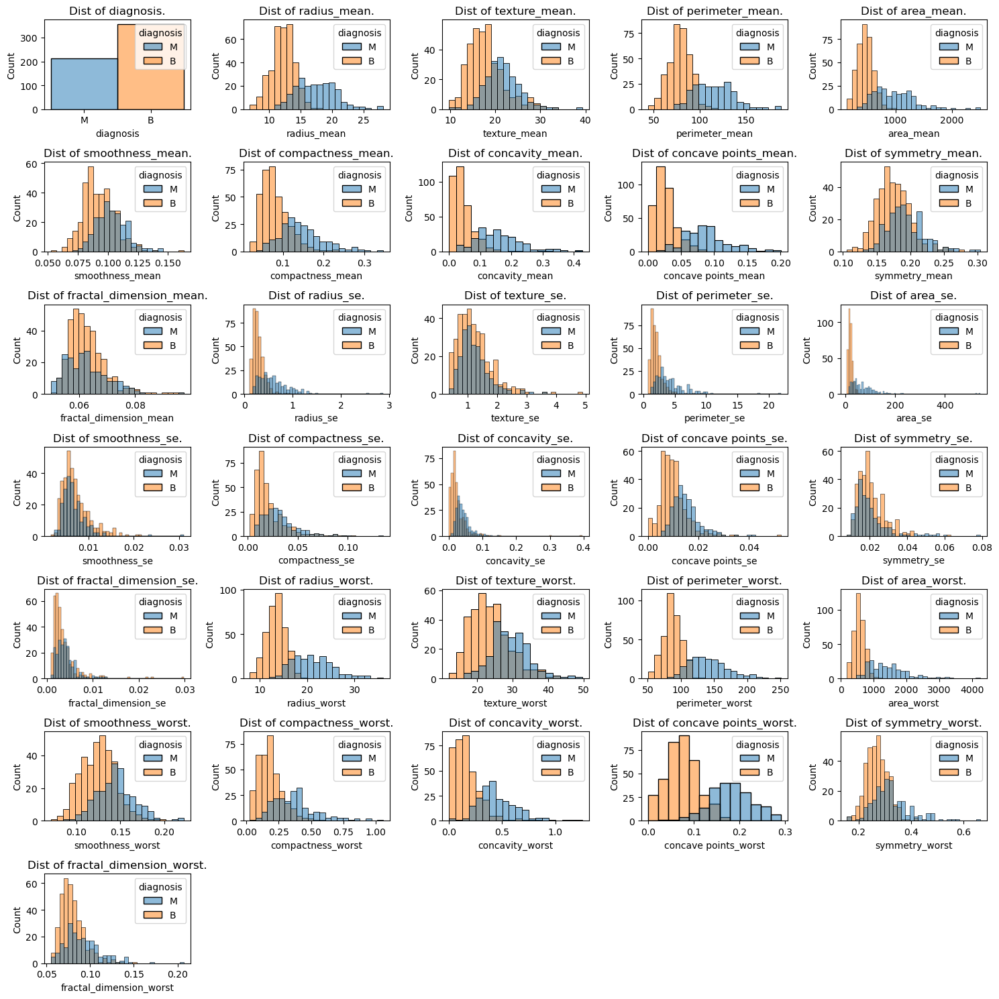

In [ ]:
# Data Distribution with Target
plt.figure(figsize=(15,15))
for idx, col in enumerate(brest_cancer_df.columns):
    plt.subplot(7,5,idx+1)
    sns.histplot(x=col, hue="diagnosis",data=brest_cancer_df)
    plt.title(f"Dist of {col}.")
 
plt.tight_layout()
plt.show()

In [ ]:
# The number of individuals with malignant tumors is lower than those with benign tumors.
# Some features, such as radius mean, area mean, and others, can be used to classify tumors with relatively clear separation. However, features like smoothness mean and smoothness SE do not exhibit a clear distinction.

In [ ]:
# Data PairPlot
sns.pairplot(brest_cancer_df, hue="diagnosis")
plt.show()

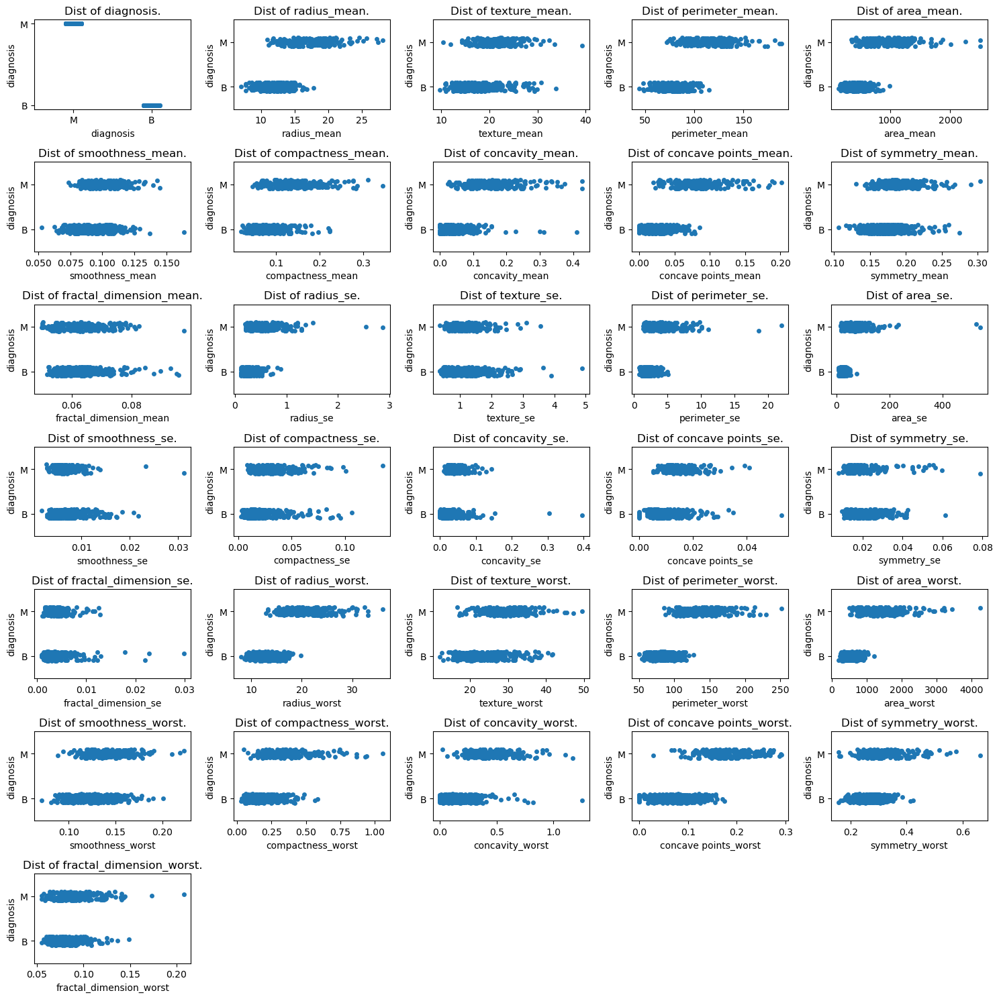

In [ ]:
# Data Distribution with Target using Stripplot
plt.figure(figsize=(15,15))
for idx, col in enumerate(brest_cancer_df.columns):
    plt.subplot(7,5,idx+1)
    sns.stripplot(x=col, y="diagnosis",data=brest_cancer_df)
    plt.title(f"Dist of {col}.")
 
plt.tight_layout()
plt.show()

In [ ]:
# From the pairplot and strip plot, we can draw the same conclusions.

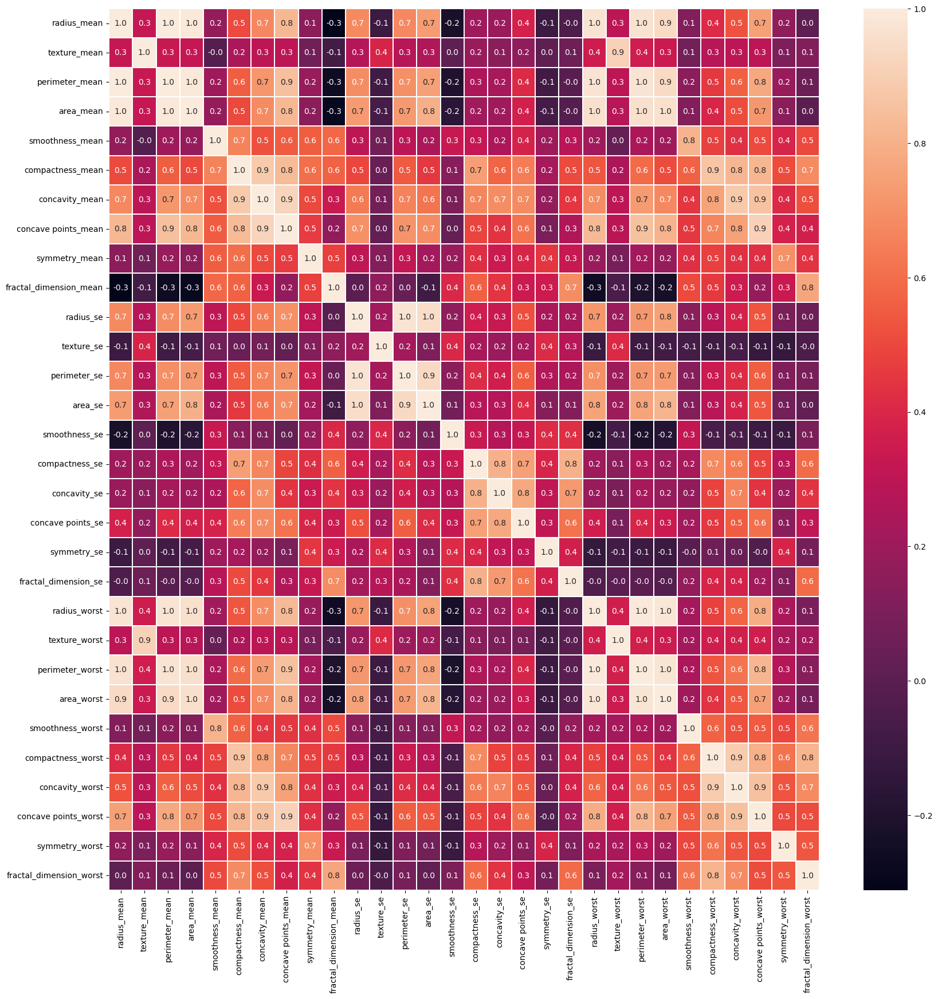

In [ ]:
# Data Correlation
plt.figure(figsize=(20,20))
sns.heatmap(brest_cancer_df.corr(numeric_only=True), annot=True, fmt="0.1f", linewidths=0.3)
plt.show()

In [ ]:
# The correlation map shows that some features are highly correlated with each other, which may impact the results. Initially, we will retain these features, and if the results are unsatisfactory, we will address them accordingly.

In [8]:
# Check Duplicates
brest_cancer_df.duplicated().sum()

0

In [9]:
# Encode Target
brest_cancer_df["diagnosis"] = brest_cancer_df["diagnosis"].replace({"M" :1, "B":0})
brest_cancer_df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [10]:
# Split Data into Features & Target
features = brest_cancer_df.drop("diagnosis", axis=1)
features.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [11]:
# Target
traget = brest_cancer_df["diagnosis"]
traget

0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: diagnosis, Length: 569, dtype: int64

In [12]:
# Split Data into Train & Test
xtrain, xtest, ytrain, ytest = train_test_split(features, traget, test_size=0.2, random_state=42, stratify=traget)
print(f"Xtrain shape: {xtrain.shape}, Xtest shape: {xtest.shape}, Ytrain shape: {ytrain.shape}, and Ytest shape: {ytest.shape}")

Xtrain shape: (455, 30), Xtest shape: (114, 30), Ytrain shape: (455,), and Ytest shape: (114,)


In [13]:
# Scale Data
scaler = StandardScaler()
xtrain_scaled = scaler.fit_transform(xtrain)
xtest_scaled = scaler.transform(xtest)

                 Model  Recall Score
0  Logistic Regression      0.952941
7              XGBoost      0.952941
6       Gradient Boost      0.947059
2                  SVC      0.947059
4        Random Forest      0.941176
5            Ada Boost      0.923529
1                  KNN      0.917647
3        Decision Tree      0.894118


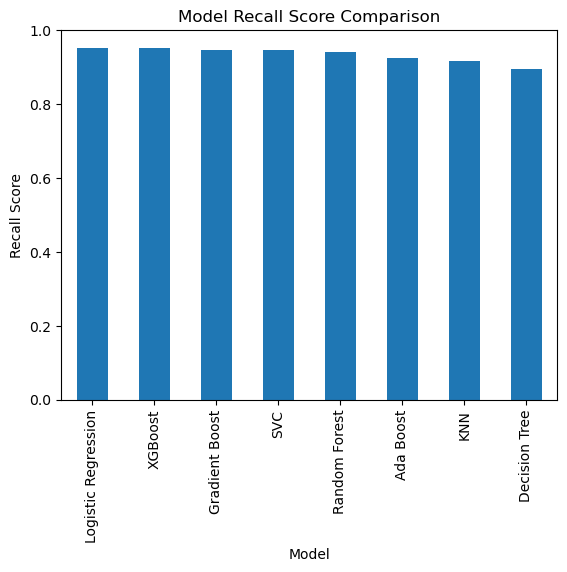

In [14]:
# Try Different Models
models = {
    "Logistic Regression" :  LogisticRegression(random_state=42),
    "KNN" : KNeighborsClassifier(),
    "SVC" : SVC(random_state=42),
    "Decision Tree" : DecisionTreeClassifier(random_state=42),
    "Random Forest" : RandomForestClassifier(random_state=42),
    "Ada Boost" : AdaBoostClassifier(random_state=42),
    "Gradient Boost" : GradientBoostingClassifier(random_state=42),
    "XGBoost" : xgb.XGBClassifier()
}


models_recall = {}
for name, model in models.items():
    cv = StratifiedKFold(n_splits=5,shuffle=True, random_state=42)
    recall = cross_val_score(model, xtrain_scaled, ytrain, cv=cv, scoring="recall", n_jobs=-1)
    models_recall[name] = recall.mean()

result = pd.DataFrame(list(models_recall.items()), columns=["Model", "Recall Score"])
print(result.sort_values(by="Recall Score", ascending=False))


# Plot the results
result.sort_values(by="Recall Score", ascending=False).plot(kind='bar', x='Model', y='Recall Score', legend=False)
plt.title("Model Recall Score Comparison")
plt.ylabel("Recall Score")
plt.show()


In [ ]:
# Since we are working with medical data, our primary focus is on recall, as the cost of misclassifying a malignant tumor as benign is much higher. 
# Additionally, we cannot rely on accuracy due to the imbalance in the dataset.

In [15]:
# Evalation Matrix
def model_evaluation(xtrain_pred, ytrain, model_pred, ytest):
    print("Train Data")
    print(f"Recall: {recall_score(xtrain_pred, ytrain)}")
    print(f"Precision: {precision_score(xtrain_pred, ytrain)}")
    print(f"F1 Score: {f1_score(xtrain_pred, ytrain)}")
    print(f"Acurracy: {accuracy_score(xtrain_pred, ytrain)}")
    print("-"*100)
    print(f"Classification Report: ")
    print(classification_report(xtrain_pred, ytrain))
    print("*"*100)
    print("*"*100)
    print("Test Data")
    print(f"Recall: {recall_score(model_pred, ytest)}")
    print(f"Precision: {precision_score(model_pred, ytest)}")
    print(f"F1 Score: {f1_score(model_pred, ytest)}")
    print(f"Acurracy: {accuracy_score(model_pred, ytest)}")
    print("-"*100)
    print(f"Classification Report: ")
    print(classification_report(model_pred, ytest))
    print("-"*100)

    sns.heatmap(confusion_matrix(model_pred, ytest), annot = True, fmt='d')
    plt.show()

Train Data
Recall: 1.0
Precision: 0.9647058823529412
F1 Score: 0.9820359281437125
Acurracy: 0.9868131868131869
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   support

           0       1.00      0.98      0.99       291
           1       0.96      1.00      0.98       164

    accuracy                           0.99       455
   macro avg       0.98      0.99      0.99       455
weighted avg       0.99      0.99      0.99       455

****************************************************************************************************
****************************************************************************************************
Test Data
Recall: 0.975
Precision: 0.9285714285714286
F1 Score: 0.9512195121951219
Acurracy: 0.9649122807017544
----------------------------------------------------------------------------------------------------
Classification Report:

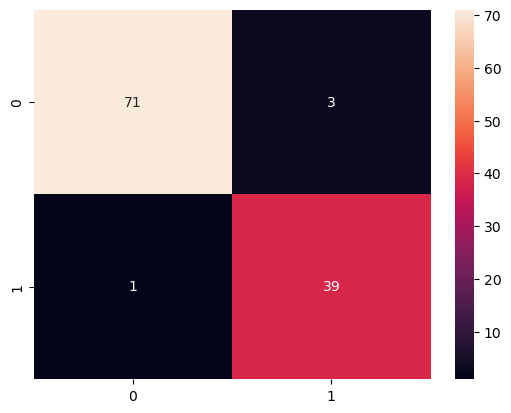

In [16]:
# Logistic Regression 
lg_model = LogisticRegression(random_state=42)
lg_model.fit(xtrain_scaled, ytrain)
xtrain_pred = lg_model.predict(xtrain_scaled)
lg_pred = lg_model.predict(xtest_scaled)
model_evaluation(xtrain_pred, ytrain, lg_pred, ytest)

Train Data
Recall: 1.0
Precision: 1.0
F1 Score: 1.0
Acurracy: 1.0
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       285
           1       1.00      1.00      1.00       170

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455

****************************************************************************************************
****************************************************************************************************
Test Data
Recall: 1.0
Precision: 0.8809523809523809
F1 Score: 0.9367088607594937
Acurracy: 0.956140350877193
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   

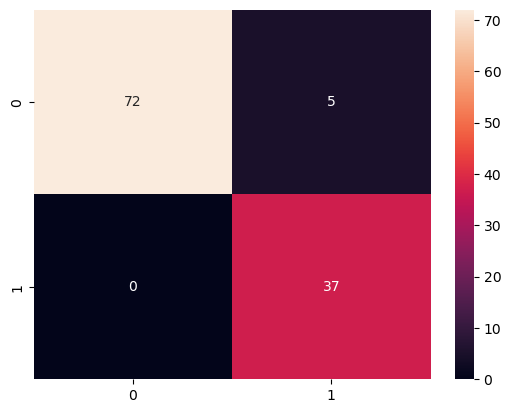

In [17]:
# XGBoost
xgb_model = xgb.XGBClassifier( random_state=42)
xgb_model.fit(xtrain_scaled, ytrain)
xtrain_pred = xgb_model.predict(xtrain_scaled)
xgb_pred4 = xgb_model.predict(xtest_scaled)
model_evaluation(xtrain_pred, ytrain, xgb_pred4, ytest)

In [18]:
# XGBoost Tuning
param_grid_xgb = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0], # 
    'gamma': [0, 0.1, 0.2],
    'reg_alpha': [0, 0.1, 1], 
    'reg_lambda': [1, 10, 100] 
    
}

grid_xgb = GridSearchCV(xgb.XGBClassifier(random_state=42), param_grid_xgb, cv=5, scoring='recall', n_jobs=-1)
grid_xgb.fit(xtrain_scaled, ytrain)

print("Best parameters for XGBoost:", grid_xgb.best_params_)
print("Best score for XGBoost:", grid_xgb.best_score_)

Best parameters for XGBoost: {'colsample_bytree': 1.0, 'gamma': 0, 'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 100, 'reg_alpha': 0, 'reg_lambda': 10, 'subsample': 0.6}
Best score for XGBoost: 0.9705882352941175


Train Data
Recall: 1.0
Precision: 0.9882352941176471
F1 Score: 0.9940828402366864
Acurracy: 0.9956043956043956
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       287
           1       0.99      1.00      0.99       168

    accuracy                           1.00       455
   macro avg       0.99      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455

****************************************************************************************************
****************************************************************************************************
Test Data
Recall: 1.0
Precision: 0.9285714285714286
F1 Score: 0.9629629629629629
Acurracy: 0.9736842105263158
----------------------------------------------------------------------------------------------------
Classification Report: 


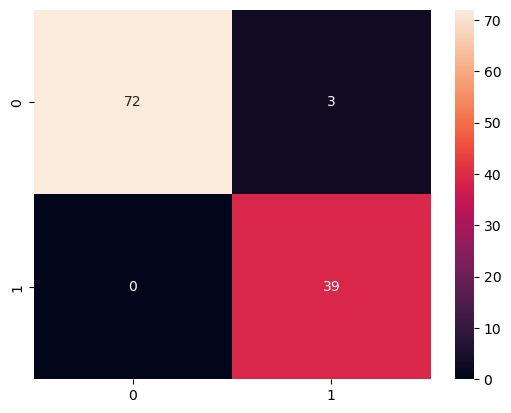

In [19]:
# Tuned XGBoos
xgb_model1 = xgb.XGBClassifier(colsample_bytree = 1, gamma = 0, learning_rate = 0.2, max_depth = 5, n_estimators = 100, reg_alpha = 0, reg_lambda = 10, subsample =0.6,  random_state=42)
xgb_model1.fit(xtrain_scaled, ytrain)
xtrain_pred = xgb_model1.predict(xtrain_scaled)
xgb_pred = xgb_model1.predict(xtest_scaled)
model_evaluation(xtrain_pred, ytrain, xgb_pred, ytest)

Train Data
Recall: 1.0
Precision: 0.9647058823529412
F1 Score: 0.9820359281437125
Acurracy: 0.9868131868131869
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   support

           0       1.00      0.98      0.99       291
           1       0.96      1.00      0.98       164

    accuracy                           0.99       455
   macro avg       0.98      0.99      0.99       455
weighted avg       0.99      0.99      0.99       455

****************************************************************************************************
****************************************************************************************************
Test Data
Recall: 1.0
Precision: 0.9285714285714286
F1 Score: 0.9629629629629629
Acurracy: 0.9736842105263158
----------------------------------------------------------------------------------------------------
Classification Report: 


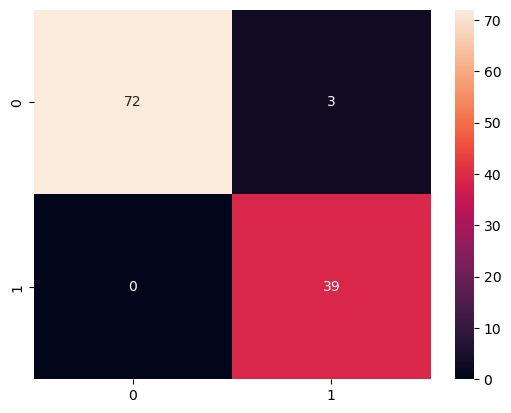

In [20]:
# SVC
svc_model = SVC( random_state=42)
svc_model.fit(xtrain_scaled, ytrain)
xtrain_pred = svc_model.predict(xtrain_scaled)
svc_pred = svc_model.predict(xtest_scaled)
model_evaluation(xtrain_pred, ytrain, svc_pred, ytest)

In [21]:
# SVC Tuning
parameters = {
    "kernel" : ["rbf", "poly", "linear"],
    "C" : [0.01, 1, 10],
    "gamma" : [0.01, 1, 10],
    "degree" : [1,2]
    
}

grid_svc = GridSearchCV(SVC(random_state=42), parameters, cv=5, scoring='recall', n_jobs=-1)
grid_svc.fit(xtrain_scaled, ytrain)

print("Best parameters for SVC:", grid_svc.best_params_)
print("Best score for SVC:", grid_svc.best_score_)

Best parameters for SVC: {'C': 10, 'degree': 1, 'gamma': 0.01, 'kernel': 'rbf'}
Best score for SVC: 0.9470588235294117


Train Data
Recall: 1.0
Precision: 0.9647058823529412
F1 Score: 0.9820359281437125
Acurracy: 0.9868131868131869
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   support

           0       1.00      0.98      0.99       291
           1       0.96      1.00      0.98       164

    accuracy                           0.99       455
   macro avg       0.98      0.99      0.99       455
weighted avg       0.99      0.99      0.99       455

****************************************************************************************************
****************************************************************************************************
Test Data
Recall: 1.0
Precision: 0.9523809523809523
F1 Score: 0.975609756097561
Acurracy: 0.9824561403508771
----------------------------------------------------------------------------------------------------
Classification Report: 
 

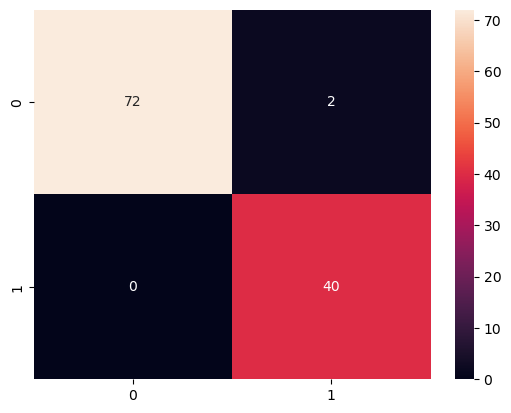

In [22]:
# Tuned SVC
svc_model1 = SVC(C=10,degree=1, gamma=0.01, kernel="rbf",  random_state=42)
svc_model1.fit(xtrain_scaled, ytrain)
xtrain_pred = svc_model1.predict(xtrain_scaled)
svc_pred1 = svc_model1.predict(xtest_scaled)
model_evaluation(xtrain_pred, ytrain, svc_pred1, ytest)

Test Data
Recall: 1.0
Precision: 0.9523809523809523
F1 Score: 0.975609756097561
Acurracy: 0.9824561403508771
----------------------------------------------------------------------------------------------------
Classification Report: 
              precision    recall  f1-score   support

           0       1.00      0.97      0.99        74
           1       0.95      1.00      0.98        40

    accuracy                           0.98       114
   macro avg       0.98      0.99      0.98       114
weighted avg       0.98      0.98      0.98       114

----------------------------------------------------------------------------------------------------


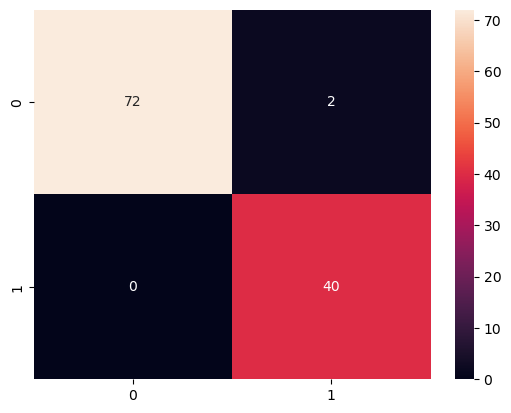

In [23]:
# Create a pipeline with preprocessing and model
pipeline = Pipeline([
    ("preprocessor" , scaler),
    ("classifier" , svc_model1)
]) 

pipeline.fit(xtrain, ytrain)
y_pred_pipeline = pipeline.predict(xtest)


print("Test Data")
print(f"Recall: {recall_score(y_pred_pipeline, ytest)}")
print(f"Precision: {precision_score(y_pred_pipeline, ytest)}")
print(f"F1 Score: {f1_score(y_pred_pipeline, ytest)}")
print(f"Acurracy: {accuracy_score(y_pred_pipeline, ytest)}")
print("-"*100)
print(f"Classification Report: ")
print(classification_report(y_pred_pipeline, ytest))
print("-"*100)

sns.heatmap(confusion_matrix(y_pred_pipeline, ytest), annot = True, fmt='d')
plt.show()


In [ ]:
# Save the trained pipeline
joblib.dump(pipeline, 'brest_cancer_model_pipeline.pkl')
print("Model pipeline saved successfully.")

Model pipeline saved successfully.
